# House price prediction using a Machine Learning model

## House Price Pridiction Project

A real estate agent gives you some information about a bunch of houses in regions of the United States,it is all in the data set: USA_Housing.csv.

The data contains the following columns:

* 'Avg. Area Income': Avg. Income of residents of the city house is located in.
* 'Avg. Area House Age': Avg Age of Houses in same city
* 'Avg. Area Number of Rooms': Avg Number of Rooms for Houses in same city
* 'Avg. Area Number of Bedrooms': Avg Number of Bedrooms for Houses in same city
* 'Area Population': Population of city house is located in
* 'Price': Price that the house sold at
* 'Address': Address for the house

## About Data

This data has taken from USA site, and this data is already preproccessed.

### Import Libraies

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [2]:
# Checkout the data
df = pd.read_csv('USA_Housing.csv')

In [3]:
df

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386
...,...,...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035,1.060194e+06,USNS Williams\nFPO AP 30153-7653
4996,78491.275435,6.999135,6.576763,4.02,25616.115489,1.482618e+06,"PSC 9258, Box 8489\nAPO AA 42991-3352"
4997,63390.686886,7.250591,4.805081,2.13,33266.145490,1.030730e+06,"4215 Tracy Garden Suite 076\nJoshualand, VA 01..."
4998,68001.331235,5.534388,7.130144,5.44,42625.620156,1.198657e+06,USS Wallace\nFPO AE 73316


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
 6   Address                       5000 non-null   object 
dtypes: float64(6), object(1)
memory usage: 273.6+ KB


In [5]:
df.describe()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5.000000e+03
mean,68583.108984,5.977222,6.987792,3.981330,36163.516039,1.232073e+06
std,10657.991214,0.991456,1.005833,1.234137,9925.650114,3.531176e+05
min,17796.631190,2.644304,3.236194,2.000000,172.610686,1.593866e+04
25%,61480.562388,5.322283,6.299250,3.140000,29403.928702,9.975771e+05
50%,68804.286404,5.970429,7.002902,4.050000,36199.406689,1.232669e+06
75%,75783.338666,6.650808,7.665871,4.490000,42861.290769,1.471210e+06
max,107701.748378,9.519088,10.759588,6.500000,69621.713378,2.469066e+06


In [6]:
df.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

## Exploratory Data Analysis (EDA)

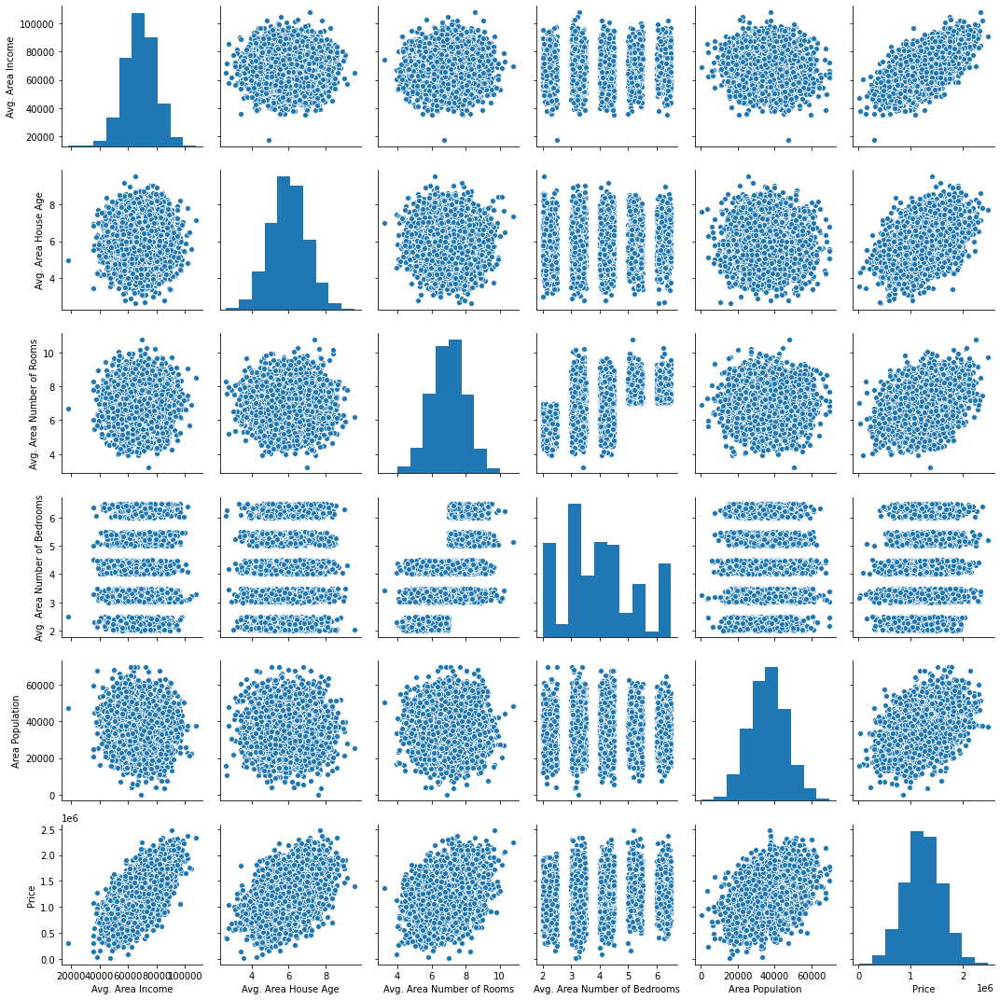

In [7]:
# Draw the pairplot
sns.pairplot(df)
plt.tight_layout()

* Here we can say that Avg. no. bedroos are: 2, 3, 4, 5, 6

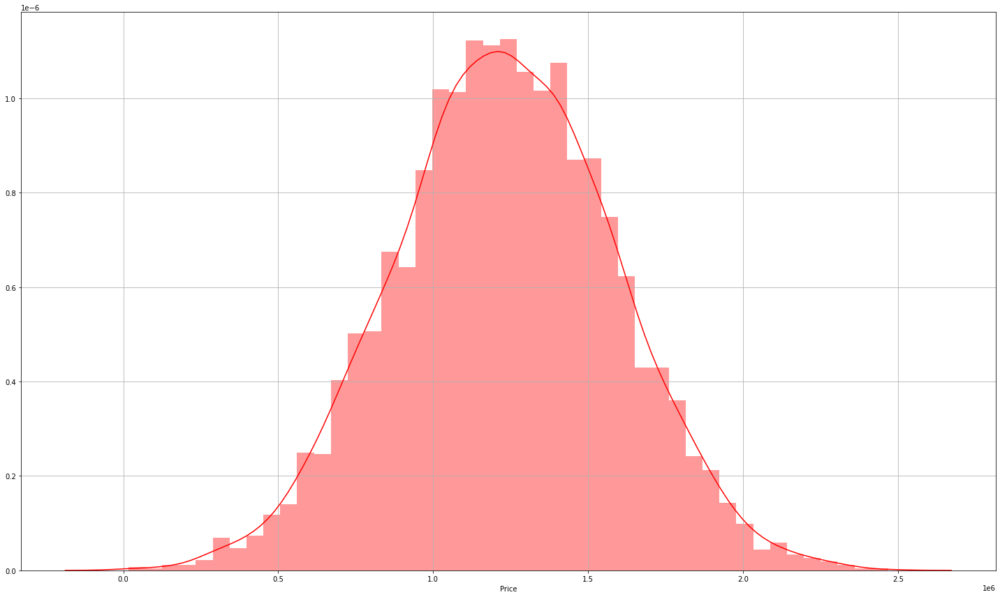

In [8]:
# Now checkout the distribution of the price
plt.figure(figsize=(20,12))
sns.distplot(df['Price'], color='red')
plt.grid()
plt.tight_layout()

To saw above graph we can say that the average price of the house falls between 1M - 1.5M

In [9]:
# Correalation Matrix
df.corr()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
Avg. Area Income,1.000000,-0.002007,-0.011032,0.019788,-0.016234,0.639734
Avg. Area House Age,-0.002007,1.000000,-0.009428,0.006149,-0.018743,0.452543
Avg. Area Number of Rooms,-0.011032,-0.009428,1.000000,0.462695,0.002040,0.335664
Avg. Area Number of Bedrooms,0.019788,0.006149,0.462695,1.000000,-0.022168,0.171071
Area Population,-0.016234,-0.018743,0.002040,-0.022168,1.000000,0.408556
Price,0.639734,0.452543,0.335664,0.171071,0.408556,1.000000


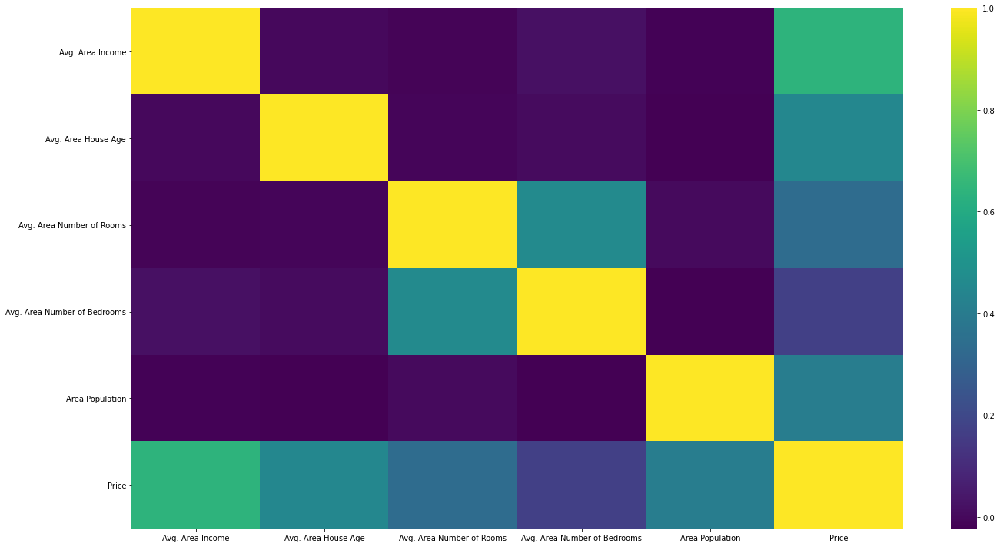

In [10]:
# Heat Map
plt.figure(figsize=(20,10))
sns.heatmap(df.corr(), cmap = 'viridis')
plt.tight_layout()

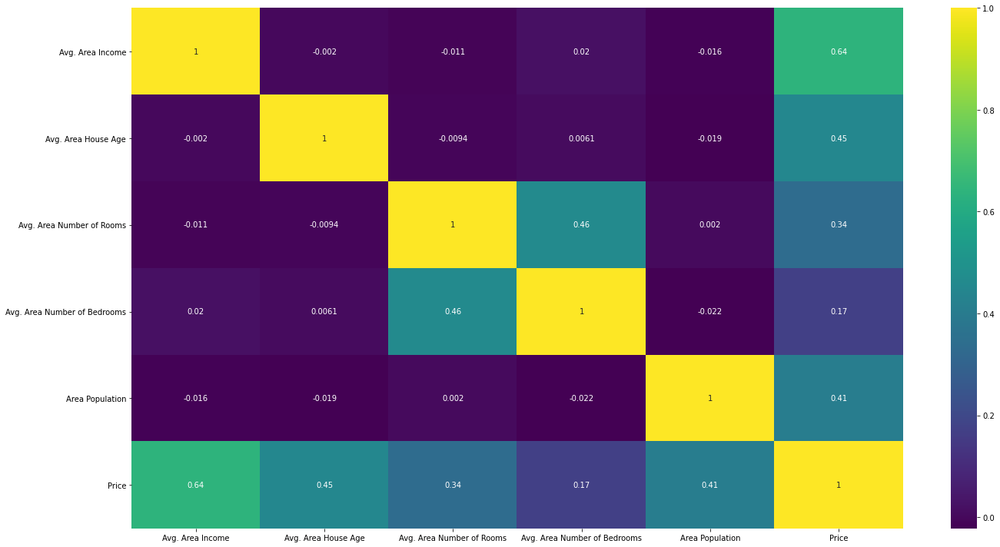

In [11]:
# Heat Ma, annot = True
plt.figure(figsize=(20,10))
sns.heatmap(df.corr(), cmap = 'viridis', annot = True)
plt.tight_layout()

## Training a Linear Regression Model

Let's now begin to train out regression model! We will need to first split up our data into an X array that contains the features to train on, and a y array with the target variable, in this case the Price column. We will toss out the Address column because it only has text info that the linear regression model can't use.


X = Input Mtrix, 
y = output vector (In this case, 'Price')

### Separate the data into 'features values' and 'target values'

### X and y arrays

* **X array = features values  (Input Matrix)**
* **y array = target values  (Output Vector)**

In [12]:
# total colums in DataFrame
df.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

In [13]:
# Define 'Input Matrix'
X = df[['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms','Avg. Area Number of Bedrooms', 'Area Population']]

In [14]:
# Check 'Input Matrix'
# Dimension = 5000x5
X

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
0,79545.458574,5.682861,7.009188,4.09,23086.800503
1,79248.642455,6.002900,6.730821,3.09,40173.072174
2,61287.067179,5.865890,8.512727,5.13,36882.159400
3,63345.240046,7.188236,5.586729,3.26,34310.242831
4,59982.197226,5.040555,7.839388,4.23,26354.109472
...,...,...,...,...,...
4995,60567.944140,7.830362,6.137356,3.46,22837.361035
4996,78491.275435,6.999135,6.576763,4.02,25616.115489
4997,63390.686886,7.250591,4.805081,2.13,33266.145490
4998,68001.331235,5.534388,7.130144,5.44,42625.620156


In [15]:
# Define the 'Output Vector'
y = df['Price']

In [16]:
# Check our 'Output Vector'
# Dimension = 5000x1
y

0       1.059034e+06
1       1.505891e+06
2       1.058988e+06
3       1.260617e+06
4       6.309435e+05
            ...     
4995    1.060194e+06
4996    1.482618e+06
4997    1.030730e+06
4998    1.198657e+06
4999    1.298950e+06
Name: Price, Length: 5000, dtype: float64

## Train Test Split

* Firsly we define our 'Input matrix' and 'Output vector'
* Now let's split the data into a training set and a testing set. We will train out model on the training set and then use the test set to evaluate the model.

In [17]:
# import the 'train_test_split model' from 'sklearn.model_selection'
from sklearn.model_selection import train_test_split

In [18]:
# Split the data into train and test sets.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=101)

In [19]:
# Data = (X, y)
# Training Data = (X_train, y_train)
# Testing Data = (X_test, y_test)
# test_size = 0.4 (40% of the whole data)
# random_state 101 (Specific set of random split on our data)

#### Check our training data

In [20]:
# Check 'training inputs matrix'
# Dimension: 3000x5
X_train

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
1303,68091.179676,5.364208,7.502956,3.10,44557.379656
1051,75729.765546,5.580599,7.642973,4.21,29996.018448
4904,70885.420819,6.358747,7.250241,5.42,38627.301473
931,73386.407340,4.966360,7.915453,4.30,38413.490484
4976,75046.313791,5.351169,7.797825,5.23,34107.888619
...,...,...,...,...,...
4171,56610.642563,4.846832,7.558137,3.29,25494.740298
599,70596.850945,6.548274,6.539986,3.10,51614.830136
1361,55621.899104,3.735942,6.868291,2.30,63184.613147
1547,63044.460096,5.935261,5.913454,4.10,32725.279544


In [21]:
# Check 'training outputs vector'
# Dimension: 3000x1
y_train

1303    1.489648e+06
1051    1.183015e+06
4904    1.547889e+06
931     1.186442e+06
4976    1.340344e+06
            ...     
4171    7.296417e+05
599     1.599479e+06
1361    1.102641e+06
1547    8.650995e+05
4959    2.108376e+06
Name: Price, Length: 3000, dtype: float64

## This is Multivariable Linear Regression

**Number of Training Examples (m) = 3000**

**Number of featurs (n) = 5**

In [22]:
# Check 'test inputs matrix'
# Dimension: 2000x5
X_test

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population
1718,66774.995817,5.717143,7.795215,4.32,36788.980327
2511,62184.539375,4.925758,7.427689,6.22,26008.309124
345,73643.057298,6.766853,8.337085,3.34,43152.139577
2521,61909.041438,6.228343,6.593138,4.29,28953.925377
54,72942.705059,4.786222,7.319886,6.41,24377.909049
...,...,...,...,...,...
1776,65173.050438,7.679469,6.602618,4.23,44125.540782
4269,42969.659393,6.295501,7.885507,4.38,29594.089863
1661,48735.924512,5.543730,6.091906,2.43,19682.347295
2410,65081.584048,5.433570,9.212518,5.14,37594.493458


In [23]:
# Check 'test outputs vector'
# Dimension: 2000x1
y_test

1718    1.251689e+06
2511    8.730483e+05
345     1.696978e+06
2521    1.063964e+06
54      9.487883e+05
            ...     
1776    1.489520e+06
4269    7.777336e+05
1661    1.515271e+05
2410    1.343824e+06
2302    1.906025e+06
Name: Price, Length: 2000, dtype: float64

## Creating and Training the Model

In [24]:
# Now import the 'LinearRegression' model from 'sklearn.linear_model'
from sklearn.linear_model import LinearRegression

In [25]:
# Now define the instances of the LinearRegression model
model = LinearRegression() # creating a LinearRegression object

In [26]:
print(dir(model)) # print all the available methods on 'model' (LinearRegression object)

['__abstractmethods__', '__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__setstate__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', '_abc_impl', '_check_n_features', '_decision_function', '_estimator_type', '_get_param_names', '_get_tags', '_more_tags', '_preprocess_data', '_repr_html_', '_repr_html_inner', '_repr_mimebundle_', '_set_intercept', '_validate_data', 'copy_X', 'fit', 'fit_intercept', 'get_params', 'n_jobs', 'normalize', 'predict', 'score', 'set_params']


#### Now we are going to use the **fit()** method to train or fit my model on my training data

In [27]:
# fit (train) my model on my training data
model.fit(X_train, y_train)

LinearRegression()

Now our LinearRegression model has been trained successfully! on my training data

## Model Evaluation

Let's evaluate the model by checking out it's coefficients and how we can interpret them.

In [28]:
# print the intercept
# intercep is the constant term of our hypothesis
print(model.intercept_)

-2640159.796853739


In [29]:
# Now check the coefficients which are associated with each feature of the training data
model.coef_

array([2.15282755e+01, 1.64883282e+05, 1.22368678e+05, 2.23380186e+03,
       1.51504200e+01])

**Now create a DataFrame based on these coefficients**

In [30]:
X_train.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population'],
      dtype='object')

In [31]:
# Creating a DataFrame 'cdf' in which:
# data = lm.coef_
# indices = X_train.columns
# columns ['Parameters']

cdf = pd.DataFrame(model.coef_, X_train.columns, columns = ['Parameters'])

In [32]:
# Now check our 'Parameter Vector'
# Dimension: 5x1
cdf

,Parameters
Avg. Area Income,21.528276
Avg. Area House Age,164883.282027
Avg. Area Number of Rooms,122368.678027
Avg. Area Number of Bedrooms,2233.801864
Area Population,15.150420


Interpreting the coefficients:

- Holding all other features fixed, a 1 unit increase in **Avg. Area Income** is associated with an **increase of \$21.52 **.
- Holding all other features fixed, a 1 unit increase in **Avg. Area House Age** is associated with an **increase of \$164883.28 **.
- Holding all other features fixed, a 1 unit increase in **Avg. Area Number of Rooms** is associated with an **increase of \$122368.67 **.
- Holding all other features fixed, a 1 unit increase in **Avg. Area Number of Bedrooms** is associated with an **increase of \$2233.80 **.
- Holding all other features fixed, a 1 unit increase in **Area Population** is associated with an **increase of \$15.15 **.

Does this make sense? If you want real data to repeat this sort of analysis, check out the [boston dataset](http://scikit-learn.org/stable/modules/generated/sklearn.datasets.load_boston.html):


For the real housing data project we can use boston data

    from sklearn.datasets import load_boston
    boston = load_boston()
    boston.keys()
    print(boston.DESCR)
    boston_df = boston.data

## Now Analysing our matrics

* **Featur vector         = X_train.columns (Dimension: nx1 == 5x1)**
* **Parameter vector (θ)  = cdf (Dimensions: nx1 == 5x1)**
* **Design Matrix         = X_train (Dimension: mxn == 3000x5)**
* **Output vector         = y_train (Dimension: mx1 == 3000x1)**

## Hypothesis:

* ## h(θ) = θ<sup>T</sup>X

* h(θ): Scaler Value

## Predictions from our Model

Let's grab predictions off our test set and see how well it did!

In [33]:
# For pridictions we use the predict() method and pass X_test (test_set) as argument
# X_test Dimension: 2000x5
# predictions Dimension: 2000x1
predictions = model.predict(X_test)

In [34]:
# Check the predictions
# 'predictions' will return predicted prices of the house according to our linear-fit-model.
# it will return an array which size of as input size (size of X_test)
predictions

array([1260960.70567629,  827588.75560301, 1742421.24254363, ...,
        372191.40626868, 1365217.15140901, 1914519.54178955])

In [35]:
# Convert the predictions from array to Series
predicted_values = pd.Series(data = predictions)

In [36]:
predicted_values

0       1.260961e+06
1       8.275888e+05
2       1.742421e+06
3       9.746254e+05
4       9.987178e+05
            ...     
1995    1.515043e+06
1996    7.460118e+05
1997    3.721914e+05
1998    1.365217e+06
1999    1.914520e+06
Length: 2000, dtype: float64

In [37]:
# Check actual values of houses
y_test

1718    1.251689e+06
2511    8.730483e+05
345     1.696978e+06
2521    1.063964e+06
54      9.487883e+05
            ...     
1776    1.489520e+06
4269    7.777336e+05
1661    1.515271e+05
2410    1.343824e+06
2302    1.906025e+06
Name: Price, Length: 2000, dtype: float64

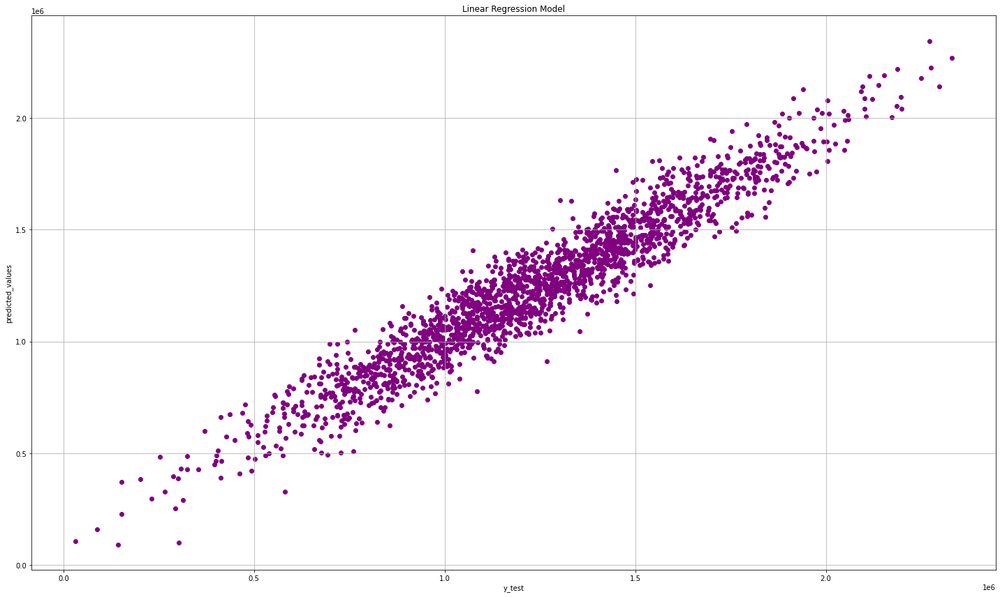

In [38]:
# Visualizing our predictions
# Draw a scatter plot between 'y_test' and 'predicted_values'
plt.figure(figsize=(20,12))
plt.xlabel('y_test')
plt.ylabel('predicted_values')
plt.title('Linear Regression Model')
plt.scatter(y_test, predicted_values, color='purple')
plt.grid()
plt.tight_layout()

* In above graph we can see that it is a perfact straight line y = x , it means that our model is pretty good
* y = x means that y_test = predicted_values

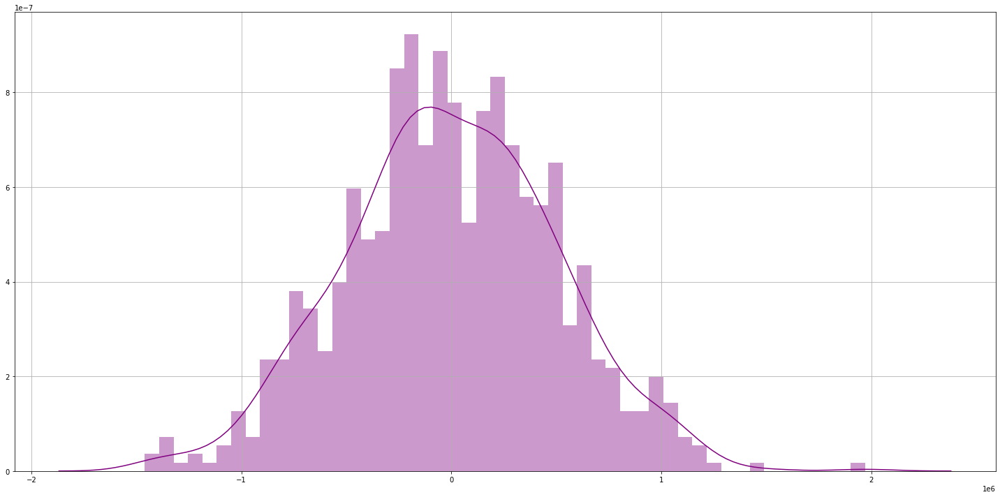

In [39]:
# Now we are going to create a histogram of the distribution of ore residues
# residues are the differnce between the actual values (y_test) and the predicted values (predicted_values)
residues = y_test - predicted_values # it will give the "absolute error"
plt.figure(figsize = (20,10))
sns.distplot((residues), bins=50, color='purple')
plt.grid()
plt.tight_layout()

**Note**: 
* In above histogram we can see that our residues are normally distributed
* If we have normally distributed residuals, it means our model is correct choice for the data

## Regression Evaluation Metrics


Here are three common evaluation metrics for regression problems:

**Mean Absolute Error** (MAE) is the mean of the absolute value of the errors:

$$\frac 1m\sum_{i=1}^m|y_i-\hat{y}_i|$$

**Mean Squared Error** (MSE) is the mean of the squared errors:

$$\frac 1m\sum_{i=1}^m(y_i-\hat{y}_i)^2$$

**Root Mean Squared Error** (RMSE) is the square root of the mean of the squared errors:

$$\sqrt{\frac 1m\sum_{i=1}^m(y_i-\hat{y}_i)^2}$$
where, 
      **m = number of training examples**

Comparing these metrics:

- **MAE** is the easiest to understand, because it's the average error.
- **MSE** is more popular than MAE, because MSE "punishes" larger errors, which tends to be useful in the real world.
- **RMSE** is even more popular than MSE, because RMSE is interpretable in the "y" units.

All of these are **loss functions** or **Cost Function**, because we want to minimize them.

**Now we importing the module 'metrics' from sklearn**

**Note**: The **metrics** module implements several loss, error, score and utitlity functions to measure performance.

In [40]:
# Import 'matrics' module from sklearn
from sklearn import metrics

In [41]:
# Now calulating errors
print('MAE:', metrics.mean_absolute_error(y_test, predicted_values)) # Mean absolute error
print('MSE:', metrics.mean_squared_error(y_test, predicted_values)) # Mean squared error
print('RMSE:', np.sqrt(metrics.mean_squared_error(y_test, predicted_values))) # Root mean squared error

MAE: 82288.22251914928
MSE: 10460958907.208244
RMSE: 102278.82922290538


In [42]:
# Now check the accuracy of our model
# Explained variance regression score function: Best possible score is 1.0, lower values are worse.
metrics.explained_variance_score(y_true=y_test, y_pred=predicted_values)

0.9178179926151899

In [43]:
accuracy = metrics.explained_variance_score(y_true=y_test, y_pred=predicted_values)
print("Our model is : ",accuracy * 100,"%", " accurate.")

Our model is :  91.781799261519 %  accurate.


### Roughly we can say that our model is 92% accurate.

### Save and Load trained model using pickle

In [44]:
# Create a Pickle file using serialization 
import pickle

pickle_out = open("model.pkl","wb")
pickle.dump(model, pickle_out)
pickle_out.close()

Now our model is saved (pickled)

Now, we have to connect this model to API